# Image Classification: EfficientNet

In this notebook, I will build a model for binary image classification of histological images.

We use the [Warwick QU gland segmentation (GlaS)](https://warwick.ac.uk/fac/sci/dcs/research/tia/glascontest/download/) data set consisting of H&E stained histological images from the GlaS@MICCAI 2015 competition.
![image](https://www.researchgate.net/publication/333000330/figure/fig1/AS:757019443200001@1557498908785/Sample-image-from-PATH-DT-MSU-dataset.jpg)

##  Introduction

![image](https://www.researchgate.net/publication/333000330/figure/fig2/AS:757019443200003@1557498908844/Results-of-the-first-phase-of-training-on-Warwick-QU-dataset-Left-to-right-source.jpg)
> Glands are important histological structures which are present in most organ systems as the main mechanism for secreting proteins and carbohydrates. It has been shown that malignant tumours arising from glandular epithelium, also known as adenocarcinomas, are the most prevalent form of cancer. The morphology of glands has been used routinely by pathologists to assess the degree of malignancy of several adenocarcinomas, including prostate, breast, lung, and colon.

> Accurate segmentation of glands is often a crucial step to obtain reliable morphological statistics. Nonetheless, the task by nature is very challenging due to the great variation of glandular morphology in different histologic grades. Up until now, the majority of studies focus on gland segmentation in healthy or benign samples, but rarely on intermediate or high grade cancer, and quite often, they are optimised to specific datasets.

> In this challenge, participants are encouraged to run their gland segmentation algorithms on images of Hematoxylin and Eosin (H&E) stained slides, consisting of a variety of histologic grades. The dataset is provided together with ground truth annotations by expert pathologists. The participants are asked to develop and optimise their algorithms on the provided training dataset, and validate their algorithm on the test dataset.

## Importing the dependencies and setting-up

### EfficientNet 

**I will be using EfficientNet-B5 architecture in Keras but why this particular architecture?**

> This is a new architecture introduced by Google AI called [EfficientNet: Improving Accuracy and Efficiency through AutoML and Model Scaling](https://ai.googleblog.com/2019/05/efficientnet-improving-accuracy-and.html) on **May 29, 2019** - _Posted by Mingxing Tan, Staff Software Engineer and Quoc V. Le, Principal Scientist, Google AI_ and it seems really interesting in terms of performance vs # of parameters for CNNs. They achieve that by basically balancing the width, depth and size of the input image of the CNN while scaling it.

_According to the Google AI Blog_ - 

> Convolutional neural networks (CNNs) are commonly developed at a fixed resource cost, 
and then scaled up in order to achieve better accuracy when more resources are made 
available. For example, ResNet can be scaled up from ResNet-18 to ResNet-200 by increasing
the number of layers, and recently, GPipe achieved 84.3% ImageNet top-1 accuracy by scaling
up a baseline CNN by a factor of four. The conventional practice for model scaling is to 
arbitrarily increase the CNN depth or width, or to use larger input image resolution for 
training and evaluation. While these methods do improve accuracy, they usually require 
tedious manual tuning, and still often yield suboptimal performance. What if, instead, 
we could find a more principled method to scale up a CNN to obtain better accuracy and efficiency?
    
![Architecture](https://1.bp.blogspot.com/-Cdtb97FtgdA/XO3BHsB7oEI/AAAAAAAAEKE/bmtkonwgs8cmWyI5esVo8wJPnhPLQ5bGQCLcBGAs/s640/image4.png)

> In our ICML 2019 paper, “EfficientNet: Rethinking Model Scaling for Convolutional Neural Networks”, 
we propose a novel model scaling method that uses a simple yet highly effective compound coefficient
to scale up CNNs in a more structured manner. Unlike conventional approaches that arbitrarily scale 
network dimensions, such as width, depth and resolution, our method uniformly scales each dimension 
with a fixed set of scaling coefficients. Powered by this novel scaling method and recent progress 
on AutoML, we have developed a family of models, called EfficientNets, which superpass state-of-the-art
accuracy with up to 10x better efficiency (smaller and faster)

** I recently observed that a lot of Kagglers were using this architecture and in some of the recent competitions this architecture has even resulted in winning solutions.**
>[Severstal: Steel Defect Detection](https://www.kaggle.com/c/severstal-steel-defect-detection)

>[APTOS 2019 Blindness Detection](https://www.kaggle.com/c/aptos2019-blindness-detection)

>[SIIM-ACR Pneumothorax Segmentation](https://www.kaggle.com/c/siim-acr-pneumothorax-segmentation)

>[iMet Collection 2019 - FGVC6](https://www.kaggle.com/c/imet-2019-fgvc6)

![performance](https://forums.fast.ai/uploads/default/optimized/3X/4/8/48d6b36d62ee83d6a6f573d9748f2c4627db9f84_2_633x500.png)
> ** References **    

> [EfficientNet: Rethinking Model Scaling for Convolutional Neural Networks](https://arxiv.org/abs/1905.11946)

> [EfficientNet Keras (and TensorFlow Keras)](https://github.com/qubvel/efficientnet)

> [State of the Art Benchmark Results on Papers with Code](https://paperswithcode.com/paper/efficientnet-rethinking-model-scaling-for)

> [fast.ai forums discussion](https://forums.fast.ai/t/efficientnet/46978)


In [1]:
%%time
print("Loading Efficient Net")
!pip install git+https://github.com/qubvel/efficientnet
from efficientnet.model import EfficientNetB5
print("Pretrained Model EfficientNetB5 has been loaded..")

Loading Efficient Net
  Cloning https://github.com/qubvel/efficientnet to /tmp/pip-req-build-yvxhqjpl
  Running command git clone -q https://github.com/qubvel/efficientnet /tmp/pip-req-build-yvxhqjpl
  Created wheel for efficientnet: filename=efficientnet-1.0.0b3-cp36-none-any.whl size=17630 sha256=6ebfe75ea01068403e18415393cdce08cad50a81b4b6610c80386464cf99517f
  Stored in directory: /tmp/pip-ephem-wheel-cache-pt6aqe2q/wheels/64/60/2e/30ebaa76ed1626e86bfb0cc0579b737fdb7d9ff8cb9522663a
Successfully built efficientnet
Pretrained Model EfficientNetB5 has been loaded..
CPU times: user 88 ms, sys: 36 ms, total: 124 ms
Wall time: 6.57 s


### Importing Libraries 

In [2]:
%%time
from __future__ import print_function, absolute_import, division
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = "retina"
%matplotlib inline

PATH = '../input/warwickqu/Warwick QU Dataset (Released 2016_07_08)/'

import gc
gc.enable()
import os
print("os result: " + str(os.listdir('../input/')))
import sys
import glob
import math
import json
import random
from datetime import datetime
csv_files = glob.glob( '../input/warwickqu/Warwick QU Dataset (Released 2016_07_08)/**.csv')
image_files = glob.glob('../input/warwickqu/Warwick QU Dataset (Released 2016_07_08)/**.bmp')
from subprocess import check_output
print("subprocess: \n" + str(check_output(["ls", "../input/"]).decode("utf8")))

import imgaug as ia
import imgaug.augmenters as iaa

import cv2
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={"figure.figsize":(12,10)})
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 2.5})
sns.set_style("whitegrid")
import scipy
from tqdm import tqdm_notebook, tqdm

from sklearn.metrics import *
from sklearn.utils import class_weight
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

import warnings
warnings.filterwarnings("ignore")

from IPython.display import display
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import keras
# import tensorflow as tf
from keras import models
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D
from keras.layers import LeakyReLU
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.utils import Sequence, to_categorical
from keras.callbacks import EarlyStopping,ModelCheckpoint,ReduceLROnPlateau,TensorBoard, Callback
from keras.optimizers import Adam, Optimizer
import keras.backend as K


def seed_everything(seed=999):
    try:
        random.seed(seed)
        os.environ['PYTHONHASHSEED'] = str(seed)
        np.random.seed(seed)
        #tf.set_random_seed(seed)
        ia.seed(seed)
        print('Random seeds initialized')
    except:
        print("There is some problem in initializing the seeds.")

seed_everything()
print("Done")

os result: ['efficientnet-keras-weights-b0b5', 'warwickqu']
subprocess: 
efficientnet-keras-weights-b0b5
warwickqu



Using TensorFlow backend.


Random seeds initialized
Done
CPU times: user 2.26 s, sys: 288 ms, total: 2.54 s
Wall time: 2.69 s


### Number of Image and CSV files 

In [3]:
print("There are totatl {} csv files in the given dataset".format(len(csv_files)))
print("There are total {} image files in the given dataset".format(len(image_files)))

There are totatl 1 csv files in the given dataset
There are total 330 image files in the given dataset


### Plotting Sample Images 

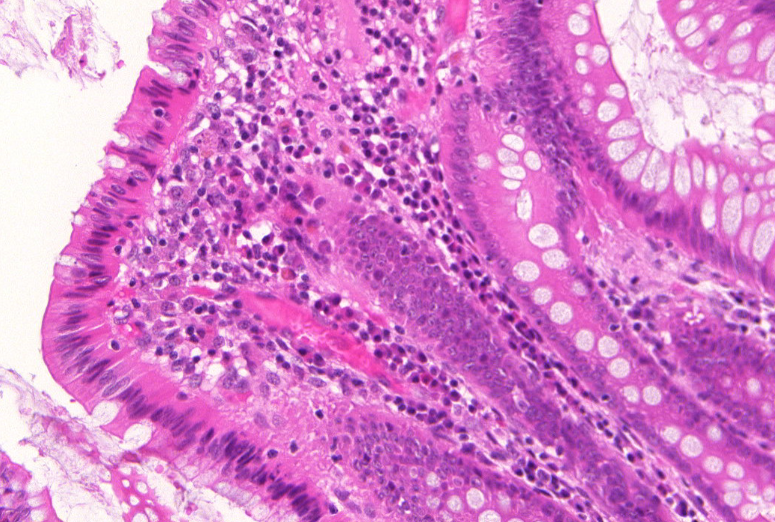

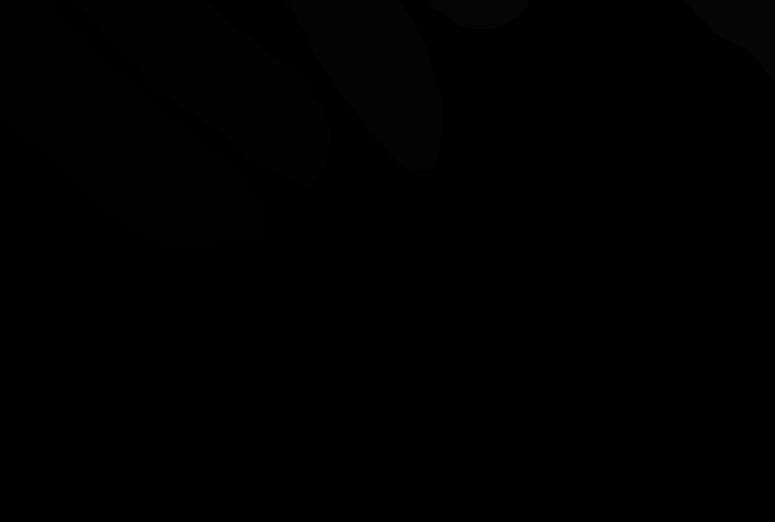

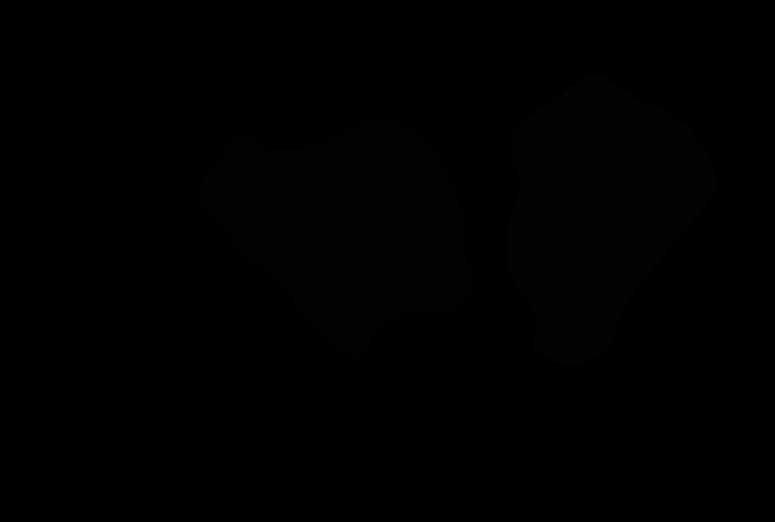

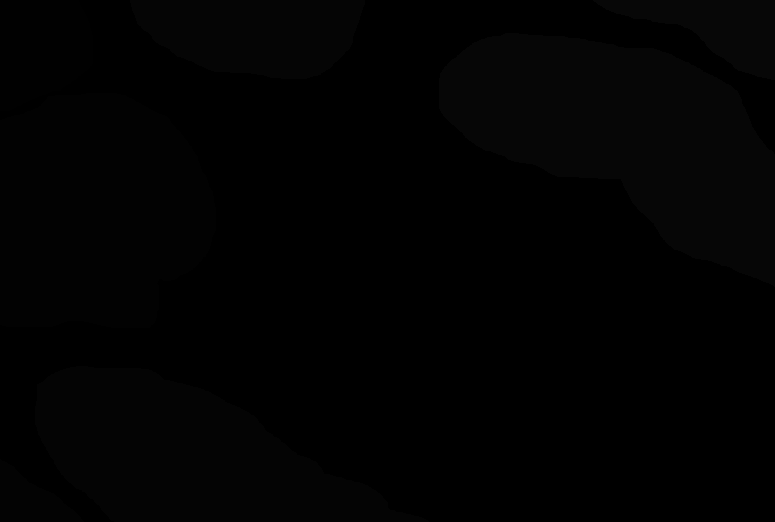

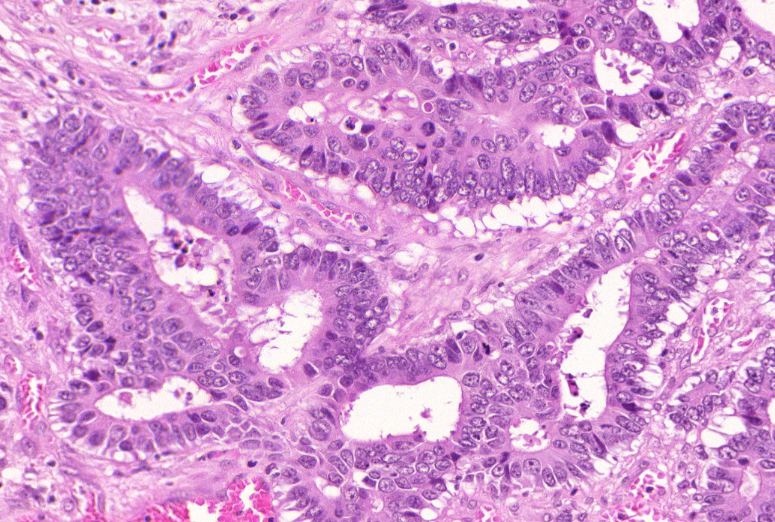

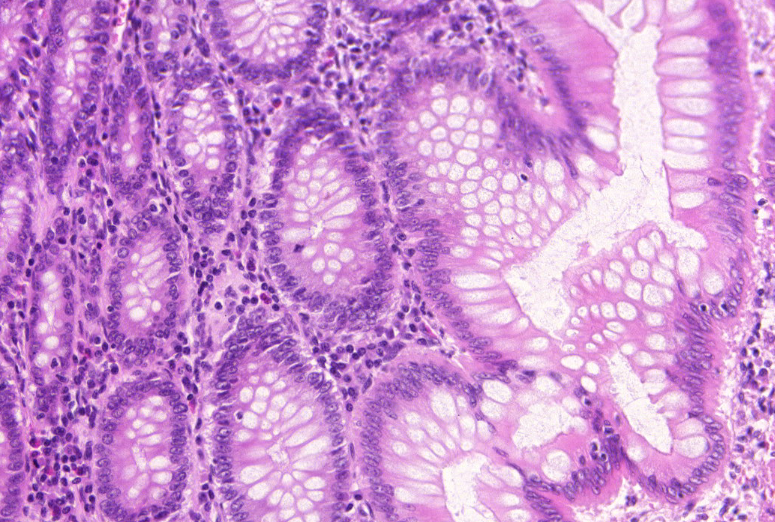

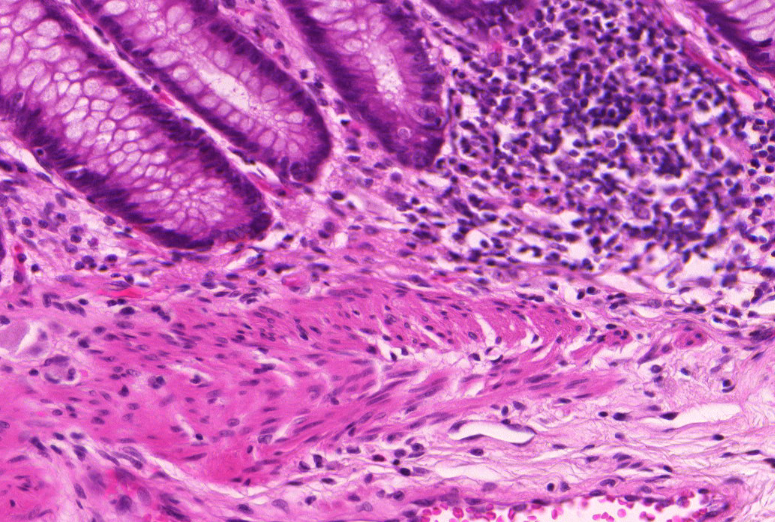

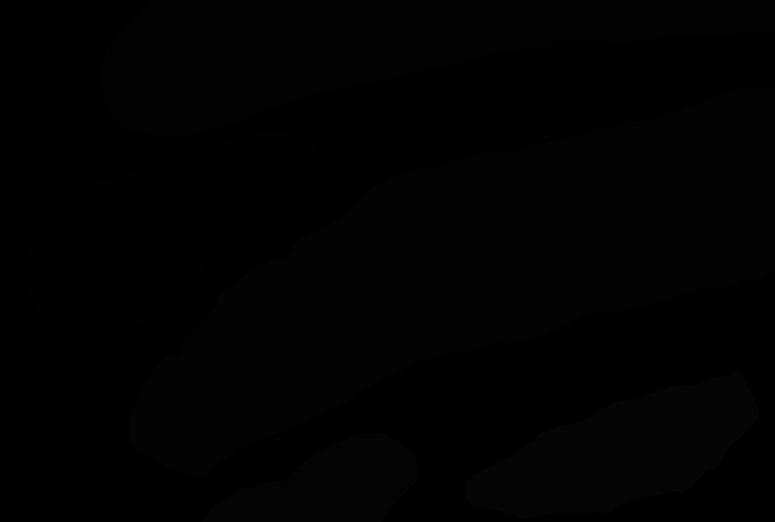

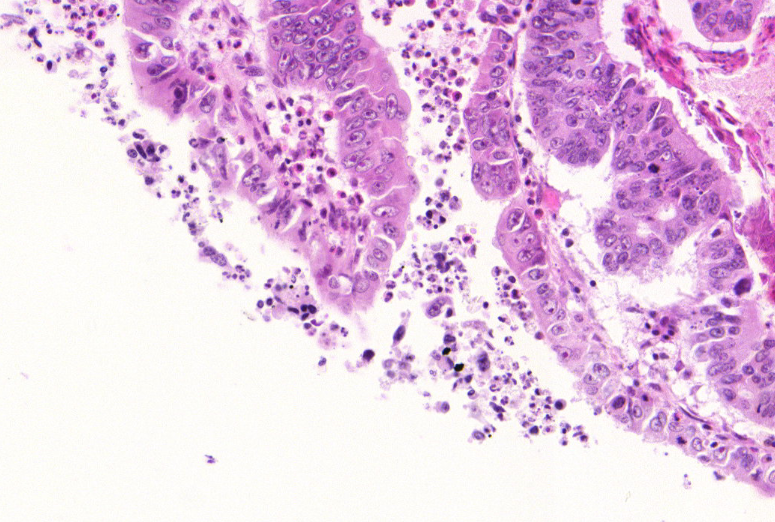

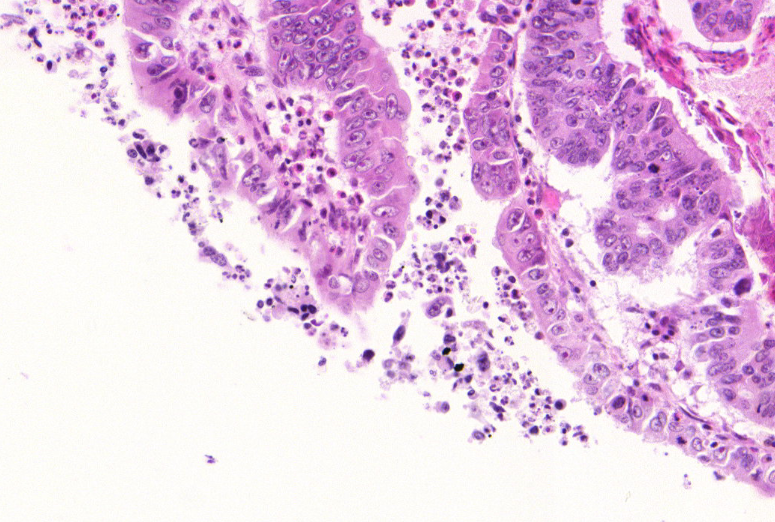

In [4]:
for i in range(10):
    idx = random.randint(0,len(image_files))
    Image.open(image_files[idx])

### Helper Function for displaying data

In [5]:
def display_all(df):
    with pd.option_context('display.max_rows',1000,'display.max_columns',1000):
        display(df)

### Display the Dataset CSV File

In [6]:
%%time
df_raw = pd.read_csv(csv_files[0],low_memory=False)
cols = df_raw.columns
display_all(df_raw)

,name,patient ID,grade (GlaS),grade (Sirinukunwattana et al. 2015)
0,testA_1,4,benign,adenomatous
1,testA_10,10,benign,healthy
2,testA_11,9,benign,healthy
3,testA_12,11,malignant,poorly differentiated
4,testA_13,7,malignant,moderately differentiated
5,testA_14,7,malignant,moderately differentiated
6,testA_15,7,malignant,moderately differentiated
7,testA_16,4,malignant,moderately differentiated
8,testA_17,7,malignant,moderately differentiated
9,testA_18,9,benign,healthy


CPU times: user 40 ms, sys: 0 ns, total: 40 ms
Wall time: 41.5 ms


### Total memory usage by the dataset

In [7]:
end_mem = df_raw.memory_usage().sum() / 1024**2
print('Memory usage is: {:.2f} MB'.format(end_mem))

Memory usage is: 0.01 MB


### Checking the data types 

In [8]:
display_all(df_raw.dtypes)

name                                     object
patient ID                                int64
 grade (GlaS)                            object
 grade (Sirinukunwattana et al. 2015)    object
dtype: object

### Dataset Information 

In [9]:
display_all(df_raw.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165 entries, 0 to 164
Data columns (total 4 columns):
name                                     165 non-null object
patient ID                               165 non-null int64
 grade (GlaS)                            165 non-null object
 grade (Sirinukunwattana et al. 2015)    165 non-null object
dtypes: int64(1), object(3)
memory usage: 5.3+ KB


None

In [10]:
display_all(df_raw.describe(include="all").T)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
name,165,165,train_9,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient ID,165,NaN,NaN,NaN,6.49091,3.90687,1,3,7,10,16
grade (GlaS),165,2,malignant,91,NaN,NaN,NaN,NaN,NaN,NaN,NaN
grade (Sirinukunwattana et al. 2015),165,5,moderately differentiated,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Check for Null Values

In [11]:
display_all(df_raw.isnull().sum().sort_index()/len(df_raw))

 grade (GlaS)                            0.0
 grade (Sirinukunwattana et al. 2015)    0.0
name                                     0.0
patient ID                               0.0
dtype: float64

In [12]:
cols = df_raw.columns
cols

Index(['name', 'patient ID', ' grade (GlaS)',
       ' grade (Sirinukunwattana et al. 2015)'],
      dtype='object')

### Plotting Labels Count

Text(0.5, 0, 'Counts')

Text(0, 0.5, 'Labels')

Text(0.5, 1.0, 'Grade (GlaS)')

Text(0.5, 0, 'Counts')

Text(0, 0.5, 'Labels')

Text(0.5, 1.0, 'Grade (Sirinukunwatana et. al 2015)')

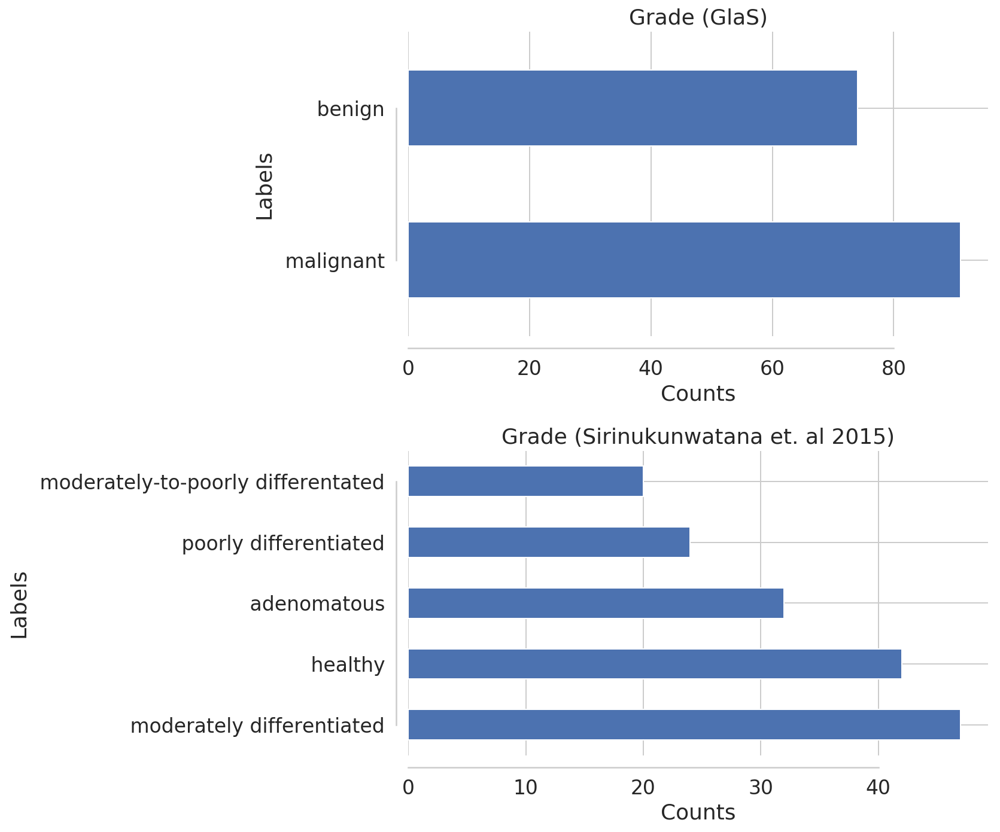

In [13]:
plt.subplot(2,1,1)
df_raw[cols[2]].value_counts().plot(kind='barh')
plt.grid(True)
sns.despine(offset=10, trim=True)
plt.xlabel("Counts")
plt.ylabel("Labels")
plt.title("Grade (GlaS)")

plt.subplot(2,1,2)
df_raw[cols[3]].value_counts().plot(kind='barh')
plt.grid(True)
sns.despine(offset=10, trim=True)
plt.xlabel("Counts")
plt.ylabel("Labels")
plt.title("Grade (Sirinukunwatana et. al 2015)")

plt.tight_layout()
plt.show()

### Preprocessing Image 

In [14]:
def get_pad_width(im, new_shape, is_rgb=True):
    pad_diff = new_shape - im.shape[0], new_shape - im.shape[1]
    t, b = math.floor(pad_diff[0]/2), math.ceil(pad_diff[0]/2)
    l, r = math.floor(pad_diff[1]/2), math.ceil(pad_diff[1]/2)
    if is_rgb:
        pad_width = ((t,b), (l,r), (0, 0))
    else:
        pad_width = ((t,b), (l,r))
    return pad_width

def preprocess_image(image_path, desired_size=224):
    im = Image.open(image_path)
    im = plt.imread(image_path)
    im = im.resize((desired_size, )*2, resample=Image.LANCZOS)    
    return im

###  Train and Validation Approach  

In [15]:
def getValSet(validation_method, train_df, foldIdx=0, fold=3):    
    if (validation_method == 'same'):
        print("Calculate Validation set with same distribution")
        target=0.2
        row_list_train = []
        row_list_val = []
        for index, row in train_df.iterrows():
            if random.random()<target: 
                row_list_val.append({"name": row["name"], "diagnosis":row["diagnosis"]})
            else:
                row_list_train.append({"name": row["name"], "diagnosis":row["diagnosis"]})
        train_df = pd.DataFrame(row_list_train)
        val_df = pd.DataFrame(row_list_val)

    if (validation_method == 'kFold'):
        print("Get kFold Validation")
        source = train_df.copy()
        kf = StratifiedKFold(n_splits = fold, shuffle = False, random_state = 2019)
        split = kf.split(source['name'], source['diagnosis'])
        for _ in range(foldIdx+1): 
            result=next(split) 
        val_df =  pd.DataFrame()
        train_df = pd.DataFrame()
        val_df = pd.concat([val_df, source.iloc[result[1]]])
        train_df = pd.concat([train_df, source.iloc[result[0]]])
        val_df.reset_index(inplace=True)
        train_df.reset_index(inplace=True)
        
    train_df['diagnosis'] = train_df['diagnosis'].astype('str')
    val_df['diagnosis'] = val_df['diagnosis'].astype('str')
    return (train_df, val_df)

### Splitting train and test data 

In [16]:
%%time
# splitting into train and test
N = df_raw.shape[0]
train_X = pd.DataFrame()
test_X = pd.DataFrame()
TRAIN_PATH = PATH
VAL_PATH = PATH

for i in range(N):
    if(df_raw['name'][i].split('_')[0]=='train'):
        train_X = pd.concat([train_X, df_raw.iloc[i]],axis=1)
    else:
        test_X = pd.concat([test_X, df_raw.iloc[i]],axis=1)
train_X = train_X.T
test_X = test_X.T

# printing the number of train and test samples
print("Number of training sample: ", train_X.shape)
print("Number of testing samples: ", test_X.shape)

# cleaning up memory
del cols
gc.collect()
cols = train_X.columns

# setting up image properties 
WIDTH = 384
HEIGHT = WIDTH
target_size=(WIDTH, HEIGHT)
df = df_raw.copy()

# Appending '.bmp' with name
train_X['name'] = train_X['name']+".bmp"

# binary label encoding
train_X['diagnosis'] = le.fit_transform(train_X[cols[0]]).astype("int")

# print(train_X['diagnosis'])

# Splitting the train and validation set
train_df, val_df = getValSet("same", train_X)


print("Number of training samples: {}".format(train_df.shape))
print("Number of Validation samples: {}".format(val_df.shape))

Number of training sample:  (85, 4)
Number of testing samples:  (80, 4)
Calculate Validation set with same distribution
Number of training samples: (65, 2)
Number of Validation samples: (20, 2)
CPU times: user 412 ms, sys: 16 ms, total: 428 ms
Wall time: 413 ms


### Data Augmentation Settings 

In [17]:
# normalize the dataset
def normalize(x):
    return (x-dataset_mean)/dataset_std

#denormalize the dataset
def denormalize(x):
    return x*dataset_std+dataset_mean

In [18]:
augment_orig_val = iaa.Sequential()

augment_strong = iaa.Sequential([
    iaa.Fliplr(0.5), # horizontally flip 50% of all images
    iaa.Flipud(0.5), # vertically flip 20% of all images
    iaa.Sometimes(0.5, iaa.Crop(percent=(0, 0.1  ))),
    iaa.Sometimes(0.5, iaa.Affine(
        scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
        translate_percent={"x": (-0.1, 0.1), "y": (-0.1, 0.1)},
        rotate=(-180, 180),
    )),
    iaa.SomeOf((0, 3),
    [
        iaa.Sometimes(0.1, 
            iaa.Superpixels(
                p_replace=(0, 0.25),
                n_segments=(20, 200)
            )
        ),
        
        iaa.OneOf([
            iaa.GaussianBlur((0, 3.0)),
            iaa.AverageBlur(k=(2, 7)),
            iaa.MedianBlur(k=(3, 5)),
        ]),
        
        iaa.Sharpen(alpha=(0, 1.0), lightness=(0.75, 1.5)),
        
        iaa.Emboss(alpha=(0, 1.0), strength=(1, 2.0)),
        
        iaa.Sometimes(0.2, iaa.OneOf([
            iaa.EdgeDetect(alpha=(0, 0.7)),
            iaa.DirectedEdgeDetect(
                alpha=(0, 0.7), direction=(0.0, 1.0)
            ),
        ])),
        
        iaa.AdditiveGaussianNoise(
            scale=(0.1, 0.03*255), per_channel=0.5
        ),
        
        iaa.OneOf([
            iaa.Dropout((0.01, 0.15), per_channel=0.5),
            iaa.CoarseDropout(
                (0.03, 0.15), size_percent=(0.03, 0.05)),
        ]),
        
        iaa.Add((-10, 10)),
        
        iaa.Multiply((0.8, 1.5)),
        
        iaa.ContrastNormalization((0.5, 2.0), per_channel=0.5),
        
        iaa.Grayscale(alpha=(0.0, 1.0)),
        
        iaa.Sometimes(0.1, 
            iaa.ElasticTransformation(alpha=(0.0, 2), sigma=0.25)
        ),

        iaa.Sometimes(0.1, iaa.PiecewiseAffine(scale=(0.01, 0.05)))
    ],
    # do all of the above augmentations in random order
    random_order=True
    )
]) 

### Data Generator 

#### Helper functions for Data Augmentation 

In [19]:
def middleCrop(img):
    h, w, _ = img.shape
    startx = int(w/2-h/2)
    return img[:, startx:startx+h, :]

def load_image(p_path, crop=False):
    try:
        image = cv2.imread(TRAIN_PATH + p_path) #read
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) #color transform
    except:
        print(f"Can't read: {p_path}")
        return None
    if crop==True: image = crop_image_from_gray(image)    
    image = cv2.resize(image, (WIDTH, HEIGHT)) #resize
    return image

def load_df(df, max_load=1000000000, path=TRAIN_PATH, crop=False):
    x = np.zeros((min(max_load, df.shape[0]), WIDTH, HEIGHT, 3), dtype='uint8')
    y = np.zeros((min(max_load, df.shape[0])), dtype='uint8')
    for idx,row in df.iterrows():
        #print("The name is: ", TRAIN_PATH+row['name'])
        x[idx, :, :, :] = load_image(row['name'], crop)
        y[idx] = row['diagnosis']
        if idx>=max_load-1: break
    print(f'Return shape: {x.shape}')
    return x,y

def crop_image_from_gray(img,tol=7):
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    mask = gray_img>tol        
    check_shape = img[:,:,0][np.ix_(mask.any(1),mask.any(0))].shape[0]
    if (check_shape == 0): 
        return img
    else:
        img1=img[:,:,0][np.ix_(mask.any(1),mask.any(0))]
        img2=img[:,:,1][np.ix_(mask.any(1),mask.any(0))]
        img3=img[:,:,2][np.ix_(mask.any(1),mask.any(0))]
        img = np.stack([img1,img2,img3],axis=-1)
    return img

#### Data Loading Class for Data Generator 

In [20]:
class DataSequence(Sequence):

    def __init__(self, df, batch_size, x_col, y_col, augment=True, shuffle=True, augmenter=None, label_smoothing=0.1):
        self.df = df
        self.batch_size = batch_size
        self.x_col = x_col
        self.y_col = y_col
        self.augment = augment
        self.shuffle = shuffle
        self.n = df['diagnosis'].count()
        self.num_classes = len(np.unique(df[y_col]))
        self.myAugmenter = augmenter
        self.label_smoothing = label_smoothing

    def __len__(self):
        return int(math.ceil(len(self.df) / float(self.batch_size)))

    def on_epoch_end(self):
        # shuffle when needed
        if self.shuffle: self.df = self.df.sample(frac=1).reset_index(drop=True)
        
    def get_batch_labels(self, idx):
        # Fetch a batch of labels
        y = np.array(self.df[self.y_col][idx * self.batch_size: (idx + 1) * self.batch_size])
        #print(self.df[self.y_col])
        y = to_categorical(y, 2)
        y = y * (1-self.label_smoothing) + self.label_smoothing/5
        return y

    def get_batch_features(self, idx):
        # Fetch a batch of inputs
        images = np.array([load_image(im) for im in self.df[self.x_col][idx * self.batch_size: (1 + idx) * self.batch_size]])
        if self.augment==True: 
            #print("Inside Augmentor")
            trans_images = normalize(np.array(self.myAugmenter.augment_images(images=images.astype('uint8'))))
        else: trans_images=normalize(np.array(images))
        return trans_images

    def __getitem__(self, idx):
        batch_x = self.get_batch_features(idx)
        batch_y = self.get_batch_labels(idx)
        return batch_x, batch_y
    
    def fitData(self, df, path = TRAIN_PATH): 
        fit_datagen =  ImageDataGenerator(
            featurewise_center=True,
            featurewise_std_normalization=True)
        x_fit, y_fit = load_df(df, 300, path)
        fit_datagen.fit(x_fit)
        global dataset_mean
        global dataset_std
        dataset_mean = fit_datagen.mean
        dataset_std = fit_datagen.std
        print("Fit Datagen Std:", fit_datagen.std)
        print("Fit Datagen Mean:", fit_datagen.mean)          

    def getGenerators(self, train_df, val_df, batch_size, augmenter, label_smoothing=0.1):
        global dataset_mean
        global dataset_std
        self.fitData(train_df, TRAIN_PATH)
        train_generator = DataSequence(
            train_df, 
            x_col="name",
            y_col="diagnosis",
            batch_size=batch_size,
            augment=True,
            shuffle=True,
            augmenter=augmenter[0],
            label_smoothing=label_smoothing
         )
        validation_generator = DataSequence(
                val_df, 
                x_col="name",
                y_col="diagnosis",
                batch_size=batch_size,
                augment=True,
                shuffle=False,
                augmenter=augmenter[1],
                label_smoothing=label_smoothing
        )
        return train_generator, validation_generator

#### Build the train and validation generator 

In [21]:
%%time
ds = DataSequence(train_df, 32, 'name','diagnosis', augmenter=augment_strong)
train_generator, validation_generator = ds.getGenerators(train_df, val_df, 32, augment_strong)
print('Done')

Return shape: (65, 384, 384, 3)
Fit Datagen Std: [[[41.830994 62.696636 32.65352 ]]]
Fit Datagen Mean: [[[205.72192 130.75958 203.48141]]]
Done
CPU times: user 848 ms, sys: 228 ms, total: 1.08 s
Wall time: 1.39 s


#### Sanity Checks before training

In [22]:
## Displaying some Sample Images
def display_samples_from_df(df, columns=4, rows=3, path=TRAIN_PATH):
    fig=plt.figure(figsize=(5*columns, 4*rows))
    idx=1
    for i in range(columns*rows):
        image_path = df.loc[i,'name']
        print("image path is: " + image_path)
        image_id = df.loc[i,'diagnosis']
        img = Image.open(path+image_path)
        height, width = img.size
        fig.add_subplot(rows, columns, idx)
        plt.title(image_id)
        plt.imshow(img)
        idx+=1
    plt.tight_layout()
    
def display_samples_from_list(x, y, columns=4, rows=3):
    fig=plt.figure(figsize=(5*columns, 4*rows))
    idx=1
    for i in range(columns*rows):
        image_path = x[i]
        image_id = y[i]
        img = Image.fromarray(image_path.astype("uint8"))
        fig.add_subplot(rows, columns, idx)
        plt.title(image_id)
        plt.imshow(img)
        idx+=1
    plt.tight_layout() 

CPU times: user 932 ms, sys: 396 ms, total: 1.33 s
Wall time: 1.06 s


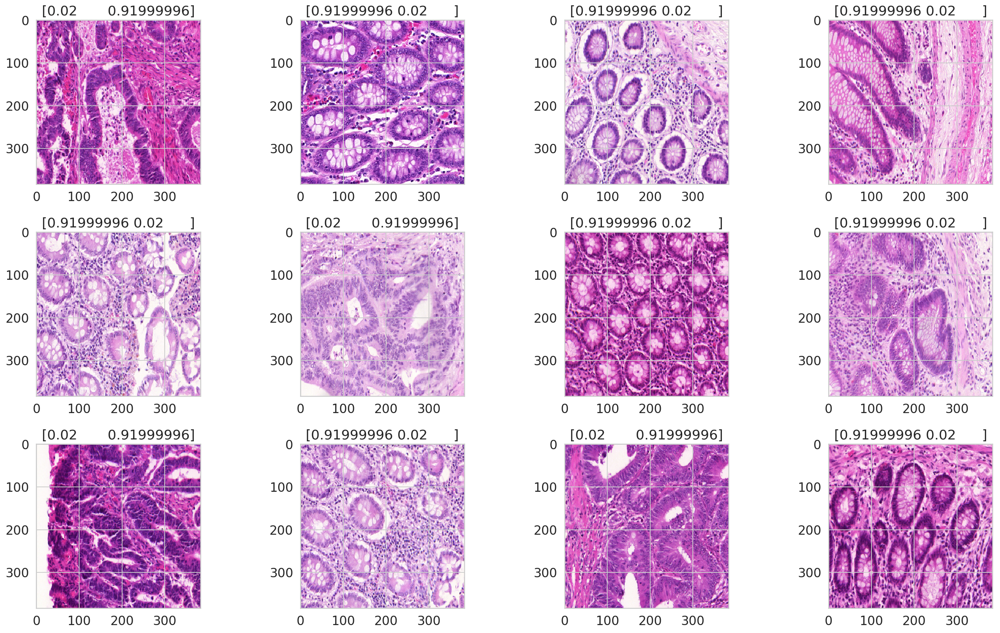

In [23]:
%%time
x, y = train_generator.__getitem__(1)
x, y = validation_generator.__getitem__(0)
display_samples_from_list(denormalize(x), y)

### Training - Phase 1

#### Build the EfficentNet B5 Model

In [24]:
def build_model():
    seed_everything()
    base = EfficientNetB5(weights='imagenet', include_top=False, input_shape=(WIDTH, HEIGHT, 3), pooling='avg', backend=keras.backend, layers=keras.layers, models=keras.models, utils=keras.utils)
    base.trainable=True
    #dropout_dense_layer = 0.2 # for B0
    #dropout_dense_layer = 0.3 # for B3
    dropout_dense_layer = 0.4  # for B5    
     
    model = Sequential()
    model.add(base)
    model.add(Dropout(dropout_dense_layer))
    model.add(Dense(2, activation='softmax'))
    
    model.compile(
        loss='categorical_crossentropy',
        optimizer=Adam(lr=0.001),
        metrics=['accuracy']
    )
    model.summary()
    return model

model = build_model()


Random seeds initialized
115515392/115515256 [==============================] - 8s 0us/step
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
efficientnet-b5 (Model)      (None, 2048)              28513520  
_________________________________________________________________
dropout_1 (Dropout)          (None, 2048)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 4098      
Total params: 28,517,618
Trainable params: 28,344,882
Non-trainable params: 172,736
_________________________________________________________________


#### Initialize Model Callbacks 

In [25]:
model_name = "model_efficientb5_cat_base.h5"
checkpoint = ModelCheckpoint(model_name, monitor='val_loss', verbose=1, save_best_only=True, mode='auto')
reduce_lr_on_plateau = ReduceLROnPlateau(monitor = 'loss',patience = 5, factor=0.3, verbose=1)

#### Compile the Model

In [26]:
model.layers[0].trainable = False
model.compile(loss='categorical_crossentropy', optimizer=Adam(lr=0.001), metrics=['accuracy'] )
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
efficientnet-b5 (Model)      (None, 2048)              28513520  
_________________________________________________________________
dropout_1 (Dropout)          (None, 2048)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 4098      
Total params: 28,517,618
Trainable params: 4,098
Non-trainable params: 28,513,520
_________________________________________________________________


#### Fit the Model

In [27]:
history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=train_generator.n/train_generator.batch_size,
                              validation_data=validation_generator,
                              validation_steps=validation_generator.n/validation_generator.batch_size,
                              epochs=60,
                              workers=6,
                              callbacks=[checkpoint, reduce_lr_on_plateau])

Epoch 1/60
3/2 [============================================] - 16s 5s/step - loss: 0.7097 - acc: 0.2915 - val_loss: 0.6698 - val_acc: 0.5500

Epoch 00001: val_loss improved from inf to 0.66981, saving model to model_efficientb5_cat_base.h5
Epoch 2/60
3/2 [============================================] - 1s 430ms/step - loss: 0.6570 - acc: 0.4547 - val_loss: 0.6745 - val_acc: 0.5500

Epoch 00002: val_loss did not improve from 0.66981
Epoch 3/60
3/2 [============================================] - 2s 503ms/step - loss: 0.5726 - acc: 0.5829 - val_loss: 0.6384 - val_acc: 0.6000

Epoch 00003: val_loss improved from 0.66981 to 0.63837, saving model to model_efficientb5_cat_base.h5
Epoch 4/60
3/2 [============================================] - 1s 434ms/step - loss: 0.5605 - acc: 0.6062 - val_loss: 0.5850 - val_acc: 0.6000

Epoch 00004: val_loss improved from 0.63837 to 0.58503, saving model to model_efficientb5_cat_base.h5
Epoch 5/60
3/2 [============================================] - 1s 43

#### Plot model history 

<Figure size 864x864 with 0 Axes>

Text(0.5, 0, 'Epochs')

Text(0, 0.5, 'Loss')

Text(0.5, 1.0, 'Training and Validation Loss')

<Figure size 864x864 with 0 Axes>

Text(0.5, 0, 'Epochs')

Text(0, 0.5, 'Accuracy')

Text(0.5, 1.0, 'Training and Validation Accuracy')

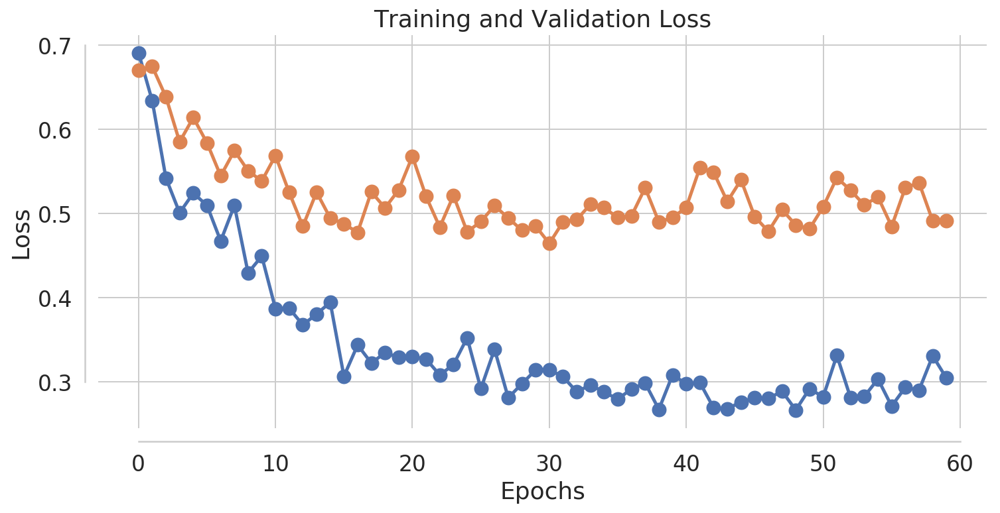

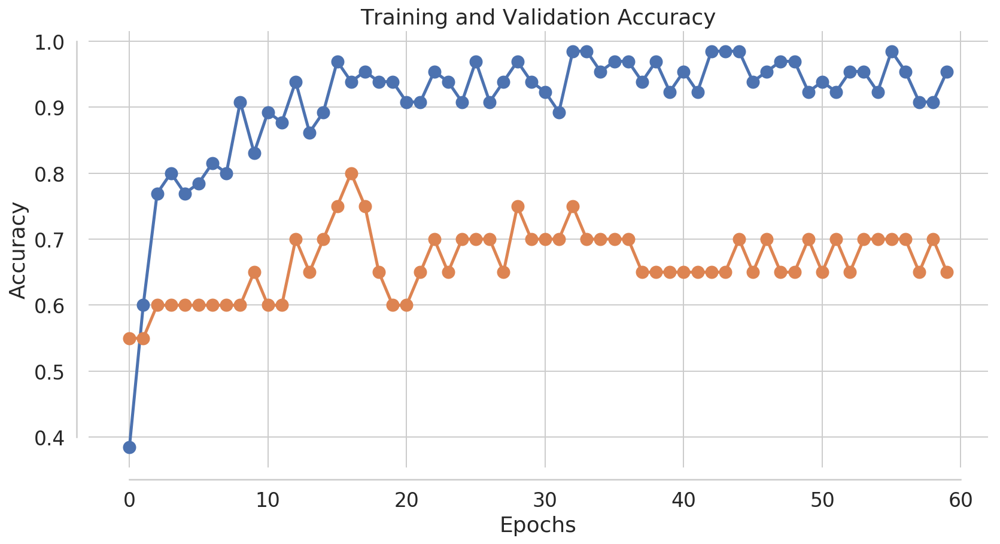

In [28]:
history_df = pd.DataFrame(history.history)

plt.figure(figsize=(12,12))
plt.subplot(2,1,1)
plt.plot(history_df[['loss', 'val_loss']],marker='o',markersize=10)
plt.grid(True)
sns.despine(offset=10, trim=True)
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training and Validation Loss")

plt.figure(figsize=(12,12))
history_df = pd.DataFrame(history.history)
plt.subplot(2,1,2)
plt.plot(history_df[['acc', 'val_acc']],marker='o',markersize=10)
plt.grid(True)
sns.despine(offset=10, trim=True)
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Training and Validation Accuracy")
plt.tight_layout()
plt.show()

#### Test the model

In [29]:
pseudo = test_X
pseudo['name'] = pseudo.name+'.bmp'
pseudo.head()

,grade (GlaS),grade (Sirinukunwattana et al. 2015),name,patient ID
0,benign,adenomatous,testA_1.bmp,4
1,benign,healthy,testA_10.bmp,10
2,benign,healthy,testA_11.bmp,9
3,malignant,poorly differentiated,testA_12.bmp,11
4,malignant,moderately differentiated,testA_13.bmp,7


In [30]:
pseudo['diagnosis'] = le.fit_transform(test_X[' grade (GlaS)']).astype("int")

#### Load test images 

Return shape: (80, 384, 384, 3)


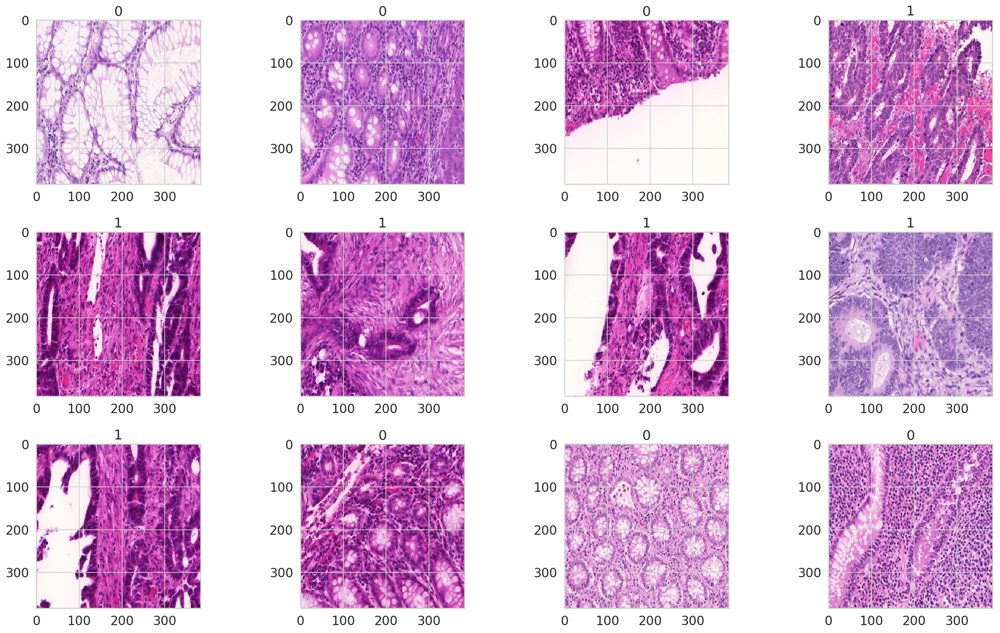

In [31]:
x_test, y_test = load_df(pseudo)
x_test = normalize(x_test)

x_eval = x_test
y_eval = y_test
display_samples_from_list(denormalize(x_eval), y_test)

#### Calculate accuracy

In [32]:
%%time
y_true = np.array(y_eval).astype('int')
model.load_weights('model_efficientb5_cat_base.h5')
predictions = model.predict(x_eval)
predictions = np.array(predictions).squeeze()
y_pred = np.argmax(predictions, axis=1)

print(y_pred[:30])
print(y_true[:30])
print("Testing accuracy: ", np.mean(np.equal(y_true, y_pred)))

[1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0]
[0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0]
Testing accuracy:  0.6125
CPU times: user 7.28 s, sys: 1.22 s, total: 8.51 s
Wall time: 8.38 s


#### Plot Confusion Matrix and Classification Report

Classification Report
              precision    recall  f1-score   support

           0       0.55      0.92      0.69        37
           1       0.83      0.35      0.49        43

    accuracy                           0.61        80
   macro avg       0.69      0.63      0.59        80
weighted avg       0.70      0.61      0.58        80

Confusion Matrix


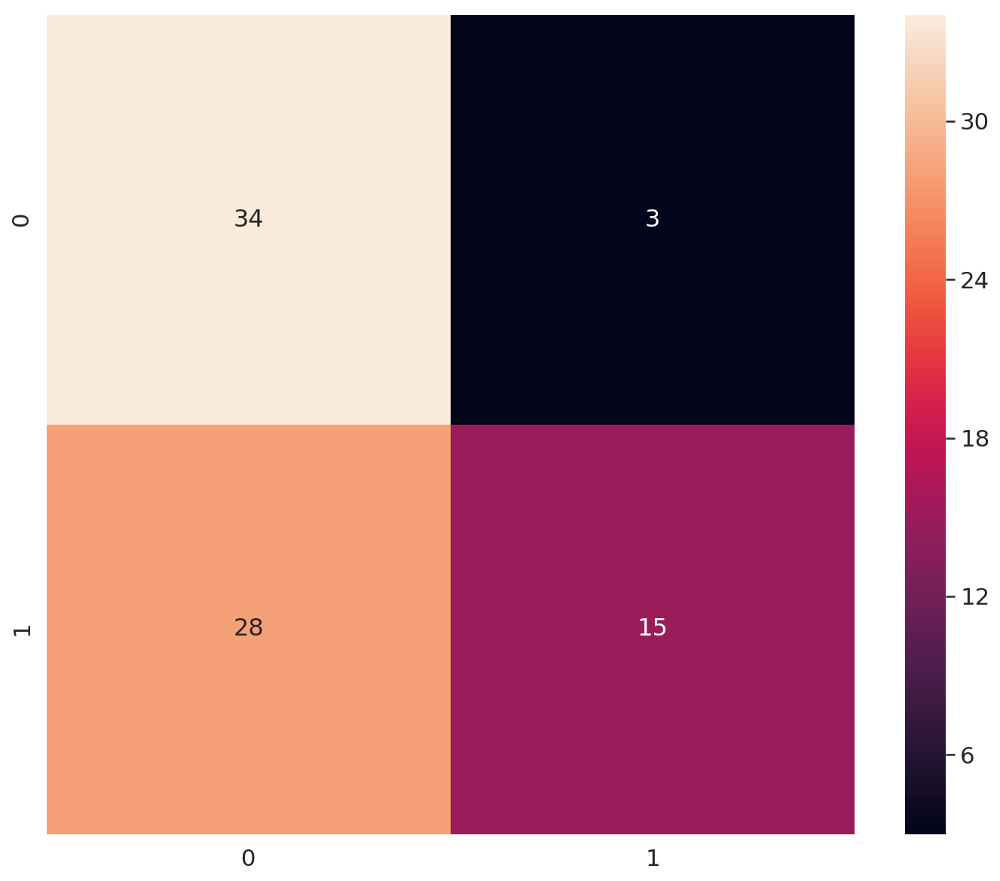

In [33]:
print('Classification Report')
target_names = ['0', '1']
print(classification_report(y_true, y_pred, target_names=target_names))

print('Confusion Matrix')
df_cm = pd.DataFrame(confusion_matrix(y_true, y_pred), range(2),range(2))
sns.set(font_scale=1.4)
sns.heatmap(df_cm, annot=True,annot_kws={"size": 16})

### Training - Phase 2

#### Unfreeze layers for more training

In [34]:
model.layers[0].trainable = True
limit = 300
for i in range(limit): model.layers[0].layers[i].trainable = False
for i in range(limit, 570): model.layers[0].layers[i].trainable = True
model.compile(loss='categorical_crossentropy', optimizer=Adam(lr=0.001), metrics=['accuracy'] )
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
efficientnet-b5 (Model)      (None, 2048)              28513520  
_________________________________________________________________
dropout_1 (Dropout)          (None, 2048)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 4098      
Total params: 28,517,618
Trainable params: 25,947,266
Non-trainable params: 2,570,352
_________________________________________________________________


#### Retrain on Unfreezed Layers and Plot Loss and Accuracy

Return shape: (65, 384, 384, 3)
Fit Datagen Std: [[[41.830994 62.696636 32.65352 ]]]
Fit Datagen Mean: [[[205.72192 130.75958 203.48141]]]
Epoch 1/15
3/2 [============================================] - 28s 9s/step - loss: 0.5648 - acc: 0.6879 - val_loss: 0.3749 - val_acc: 0.8500

Epoch 00001: val_loss improved from 0.46443 to 0.37486, saving model to model_efficientb5_cat_base.h5
Epoch 2/15
3/2 [============================================] - 2s 714ms/step - loss: 0.2549 - acc: 0.9650 - val_loss: 0.2249 - val_acc: 0.9500

Epoch 00002: val_loss improved from 0.37486 to 0.22491, saving model to model_efficientb5_cat_base.h5
Epoch 3/15
3/2 [============================================] - 2s 683ms/step - loss: 0.2801 - acc: 0.7462 - val_loss: 0.1256 - val_acc: 1.0000

Epoch 00003: val_loss improved from 0.22491 to 0.12556, saving model to model_efficientb5_cat_base.h5
Epoch 4/15
3/2 [============================================] - 2s 654ms/step - loss: 0.2463 - acc: 1.0000 - val_loss: 0.2

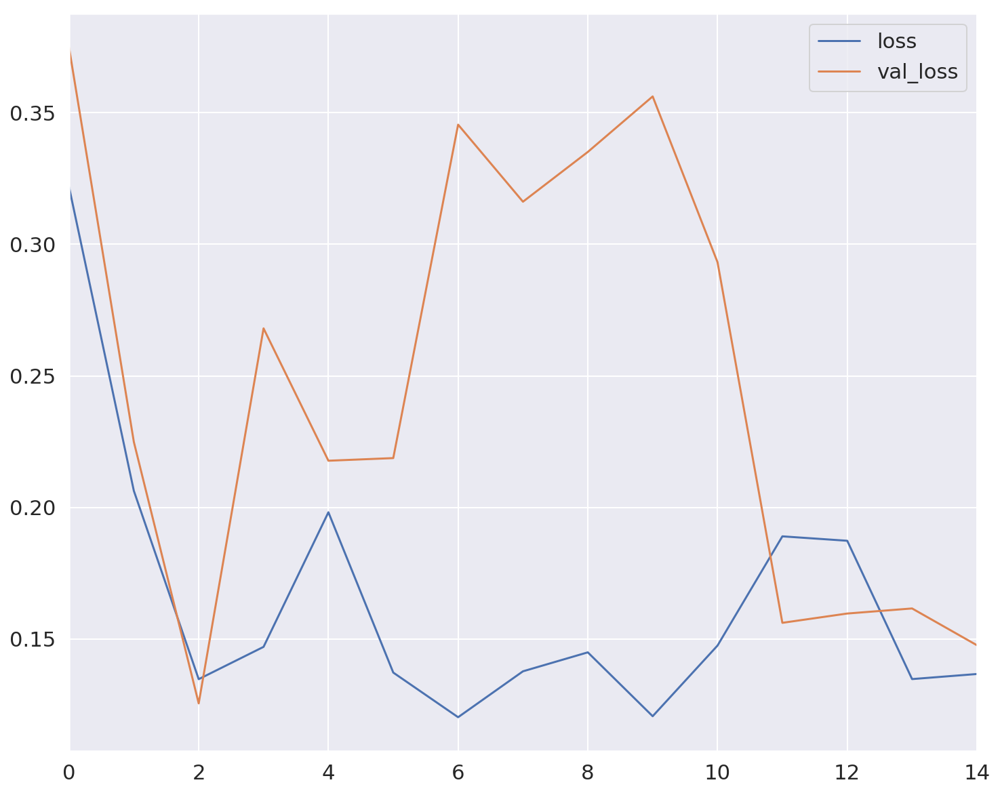

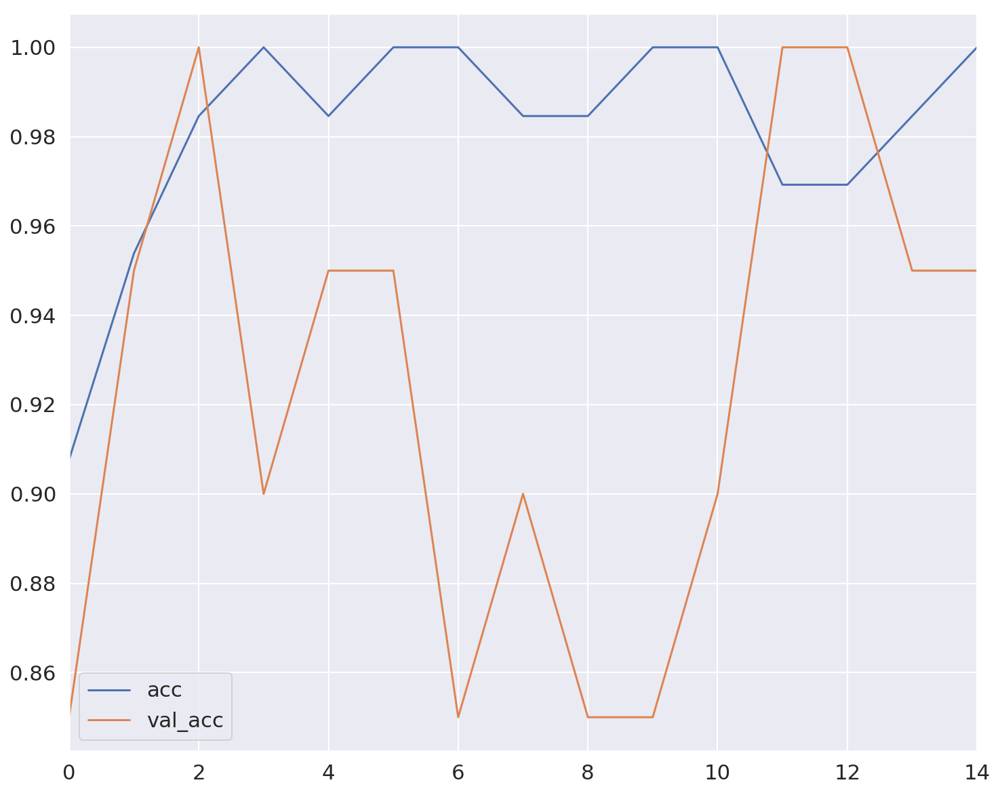

In [35]:
train_generator, validation_generator = ds.getGenerators(train_df, val_df, 32, augment_strong)
history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=train_generator.n/train_generator.batch_size,
                              validation_data=validation_generator,
                              validation_steps=validation_generator.n/validation_generator.batch_size,
                              epochs=15,
                              workers=6,
                              callbacks=[checkpoint, reduce_lr_on_plateau])

history_df = pd.DataFrame(history.history)
history_df[['loss', 'val_loss']].plot()
history_df[['acc', 'val_acc']].plot()

#### Save Model Weights 

In [36]:
model.save_weights(model_name)

#### Load the test images 

Return shape: (80, 384, 384, 3)


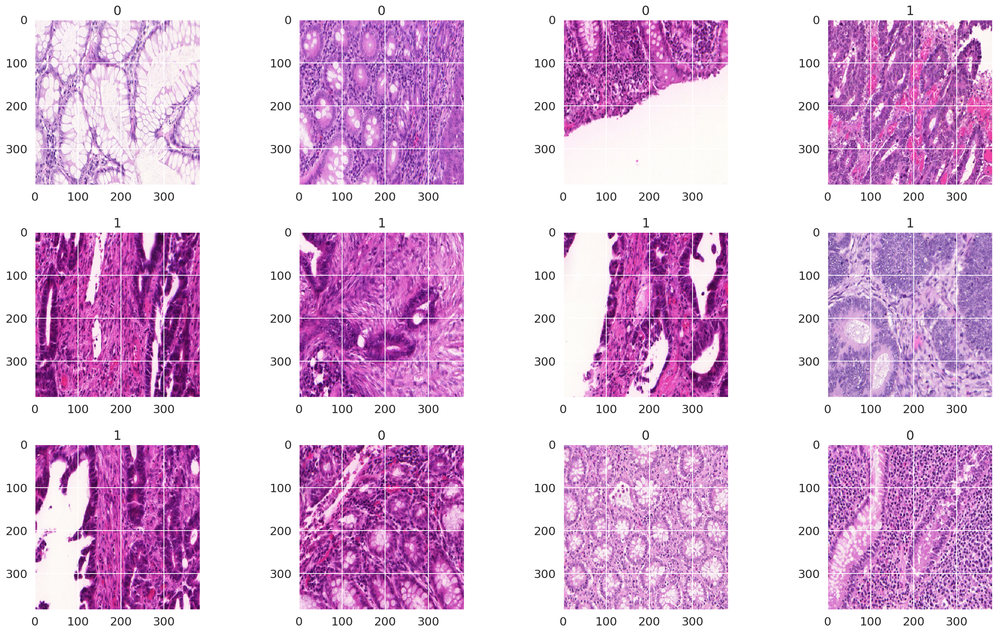

In [37]:
x_test2, y_test2 = load_df(pseudo)
x_test2 = normalize(x_test2)

x_eval2 = x_test2
y_eval2 = y_test2
display_samples_from_list(denormalize(x_eval2), y_test2)

#### Check if our current and previous test set are same

In [38]:
np.allclose(x_test,x_test2)
np.allclose(y_test, y_test2)

True

True

#### Plot Testing Accuracy

In [39]:
%%time
y_true = np.array(y_eval).astype('int')
model.load_weights('model_efficientb5_cat_base.h5')
predictions = model.predict(x_eval)
predictions = np.array(predictions).squeeze()
y_pred = np.argmax(predictions, axis=1)

print(y_pred[:30])
print(y_true[:30])
print("Testing accuracy: ", np.mean(np.equal(y_true, y_pred)))

[0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 0]
[0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0]
Testing accuracy:  0.9375
CPU times: user 5.52 s, sys: 1.01 s, total: 6.53 s
Wall time: 6.38 s


#### Plot Classification Report and Confusion Matrix 

Classification Report
              precision    recall  f1-score   support

           0       0.90      0.97      0.94        37
           1       0.97      0.91      0.94        43

    accuracy                           0.94        80
   macro avg       0.94      0.94      0.94        80
weighted avg       0.94      0.94      0.94        80

Confusion Matrix


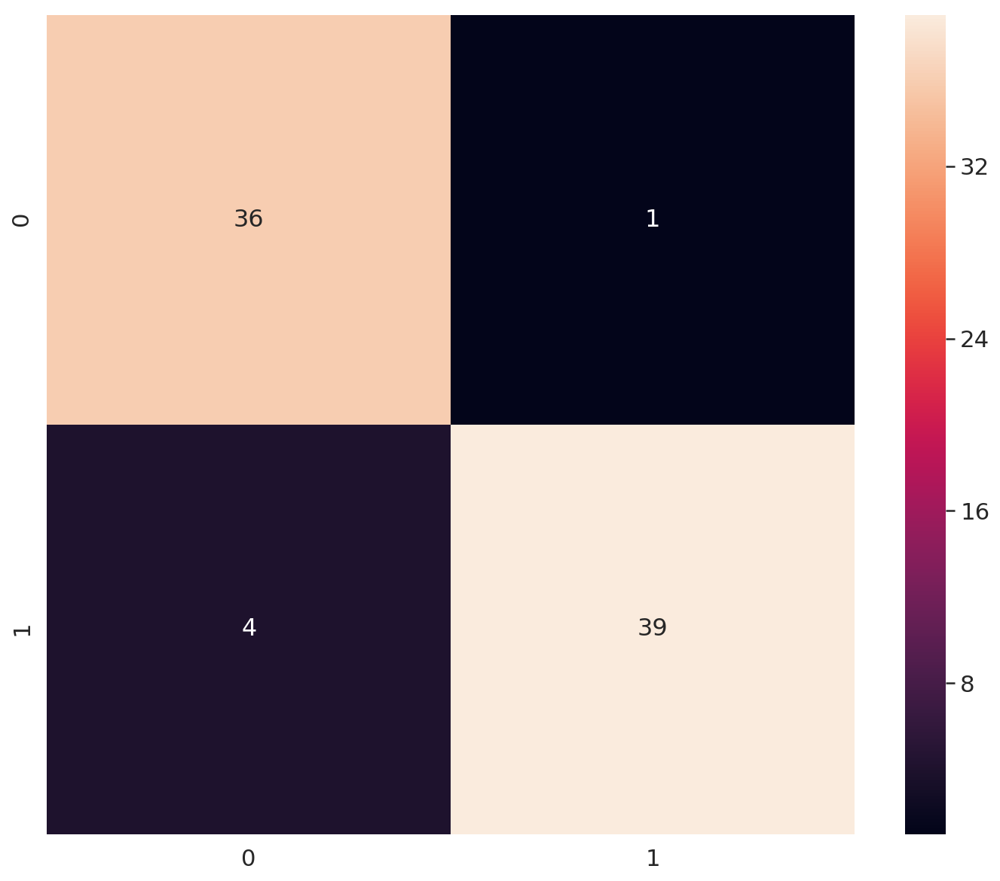

In [40]:
print('Classification Report')
target_names = ['0', '1']
print(classification_report(y_true, y_pred, target_names=target_names))

print('Confusion Matrix')
df_cm = pd.DataFrame(confusion_matrix(y_true, y_pred), range(2),range(2))
sns.set(font_scale=1.4)
sns.heatmap(df_cm, annot=True,annot_kws={"size": 16})

#### Save Predictions in DataFrame

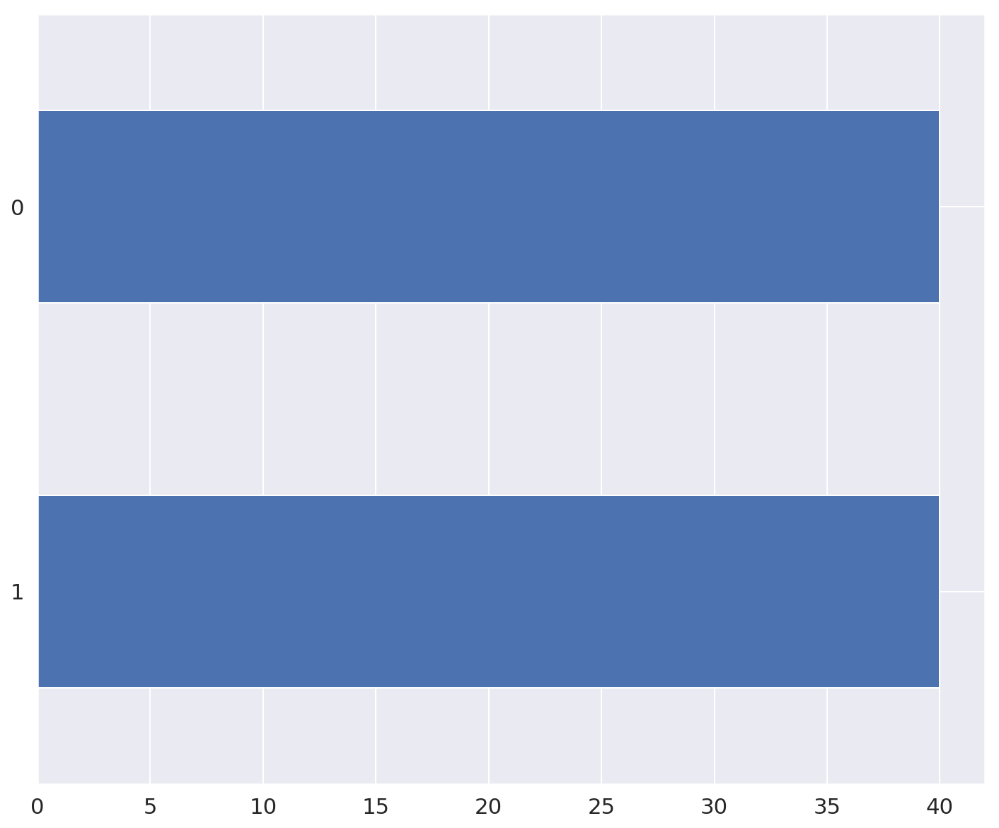

In [41]:
preds = pd.DataFrame(y_pred,index=range(len(y_pred)),columns=["y_pred"])
preds["y_pred"].value_counts().plot(kind="barh")
plt.grid(True)

#### Plot Predicted Count 

Text(0.5, 1.0, 'Predicted Labels')

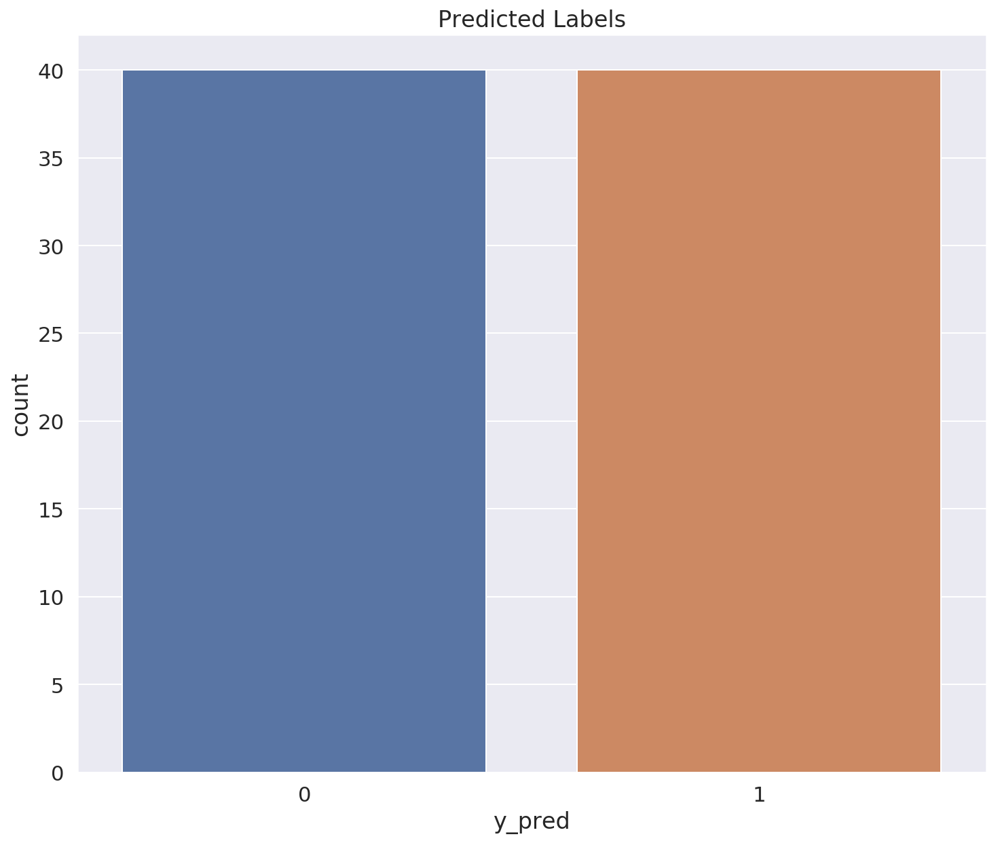

In [42]:
plt.title('Predicted Labels')
sns.countplot(preds["y_pred"])

#### Plot True Count

Text(0.5, 1.0, 'True Labels')

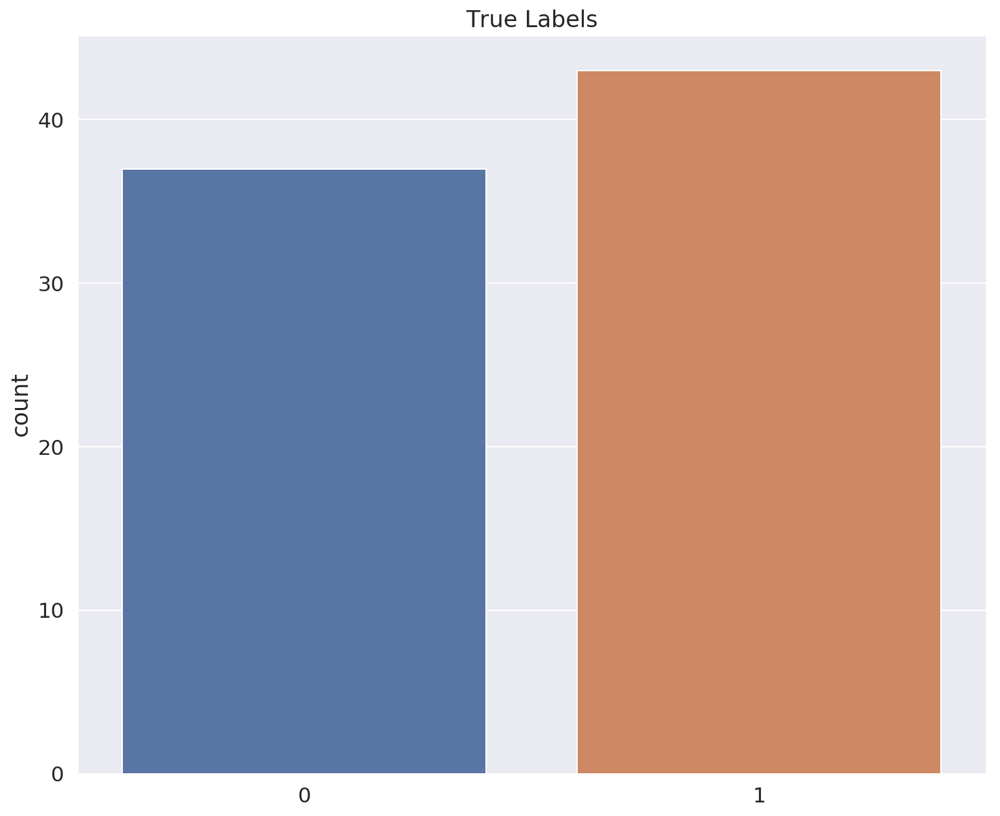

In [43]:
plt.title('True Labels')
sns.countplot(y_test2)

#### Saving to CSV file

In [ ]:
%%time
print("Saving Predictions to CSV file..")
preds.to_csv('predictions.csv',index=False)
print("Done.!")